<a href="https://colab.research.google.com/github/j0rge-20/Precip/blob/main/Mapa_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#install libraries for plotting
!pip install geopandas
!pip install gpdvega
!pip install altair vega_datasets
!pip install pandasql

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon
from pandasql import sqldf
import altair as alt
from vega_datasets import data
import gpdvega

#sql function def
pysqldf = lambda q: sqldf(q, globals())


     |████████████████████████████████| 972kB 12.4MB/s 
     |████████████████████████████████| 6.5MB 33.3MB/s 
     |████████████████████████████████| 14.8MB 249kB/s 
  Created wheel for pandasql: filename=pandasql-0.7.3-cp36-none-any.whl size=26820 sha256=16afebe798ae7d35f900ee68d1209768bc7cd4f79966ca9ac252643badc47252
  Stored in directory: /root/.cache/pip/wheels/53/6c/18/b87a2e5fa8a82e9c026311de56210b8d1c01846e18a9607fc9
Successfully built pandasql


In [ ]:

#cargar shape mapa Cundinamarca
shape_file = 'Municipios_de_Cundinamarca.shp'
#cargar geopandas mapa cundinamarca
cundi_map = gpd.read_file(shape_file)

#cargar info estaciones
dataset_path = 'https://raw.githubusercontent.com/j0rge-20/Precip/main/Estaciones.csv'
df = pd.read_csv(dataset_path)

#coordenadas
crs = {'init':'epsg:3116'}

#estaciones
estaciones = ['2120540','2306507','2120557','2401519','2120562','2120548','2120559','2120561','2120629','2401513','2120639','2120630','2120646','2120641','2120644','2120647','2119514','2306517','2306516'] 

########################################################PARAMETROS############################################# 
#umbral precipitacion
umbral_pre = 40
#mes analisis
mes = '5'
#Escala calificacion
esc = ['Adecuada','Inadecuada']
#meses
meses =['-','enero','febrero','marzo','abril','mayo','junio','julio','agosto','septiembre','octubre','noviembre','diciembre']

########################################################PARAMETROS############################################# 

#dataset predicciones
#path3 = "https://raw.githubusercontent.com/j0rge-20/Precip/main/consolidado_predicciones.csv"
#path3 = "https://raw.githubusercontent.com/j0rge-20/Precip/main/ds_predicciones.csv"
path3 = "https://raw.githubusercontent.com/j0rge-20/Precip/main/Predicciones_V4.csv"
dfp = pd.read_csv(path3, parse_dates=['Fecha'],index_col="Fecha")
#ajustes datafreame
dfp['Precipitacion'] = round(dfp['Precipitacion'],2) 
dfp['Agricultura'] = np.where(dfp['Precipitacion'] > umbral_pre ,esc[0],esc[1])


#info estaciones analisis
dfp1 = df[df['estacion'].isin(estaciones)].copy()
#info predicciones
dfp2 = sqldf('select Estacion as estacion, Precipitacion as precipitacion , agricultura as agricultura from dfp where mes='+mes+'') 
#combinar info dataframes
dft = pd.merge(dfp1,dfp2,on='estacion')
#dft.dtypes

#crear geopandas dataframe
geometry = [Point(xy) for xy in zip(dfp1["x"], dfp1["y"])]
geo_df = gpd.GeoDataFrame(dft, crs = crs, geometry = geometry)
#print(geo_df.head())


#definir gráfico estaciones

#tamanio
w=700
h=600

#escala de color
dominio = [esc[0], esc[1]]
rango = ['#06d6a0', '#e5383b']



#titulo
t = 'Zonas agrícolas Cundinamarca - '+meses[int(mes)]+' '


points = alt.Chart(geo_df).mark_circle(size = 150).encode(
    latitude = 'latitud',
    longitude = 'longitud',
    size=alt.Size('precipitacion:Q', legend= alt.Legend(title = 'Precipitación(mm)',labelFontSize = 14,titleFontSize =16)),
    #color= alt.value('#219ebc'),
    #color = alt.condition(alt.datum.precipitacion < umbral_pre,alt.value('#e63946'),alt.value('#006d77') ),    
    color = alt.Color('agricultura',scale = alt.Scale(domain = dominio, range = rango),legend= alt.Legend(title = 'Zona agrícola',labelFontSize = 14,titleFontSize =16)),
    #tooltip=['ciudad:N','precipitacion:N'] # GeoDataFrame.index is accessible as id
    tooltip=[alt.Tooltip('ciudad:N',title='Ciudad') , alt.Tooltip('precipitacion:N',title='Precipitación (mm)')] # GeoDataFrame.index is accessible as id
).properties(
    width=w,
    height=h
)

#definir gráfico Cundinamarca
background = alt.Chart(cundi_map).mark_geoshape(
    #fill='lightgray',
    fill='#edf2f4',
    stroke='lightgray'
).properties(
    width=w,
    height=h,
)

#background + points

#layered chart
chart = alt.LayerChart(layer=(background, points),title = t).configure_title(
    fontSize=25,
    #font='Courier',
    anchor='middle',
    color='black'
)

#chart plotting
chart

#customize color
#Color Domain and Range
#https://altair-viz.github.io/user_guide/customization.html

#https://altair-viz.github.io/user_guide/generated/core/altair.Legend.html?highlight=mark%20circle






/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/usr/local/lib/python3.6/dist-packages/altair/utils/data.py:229: AltairDeprecationWarning: alt.pipe() is deprecated, and will be removed in a future release. Use toolz.curried.pipe() instead.
  AltairDeprecationWarning,
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:1490: FutureWarning: Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.
  FutureWarning,


alt.LayerChart(...)

In [ ]:
#definir gráfico estaciones

points = alt.Chart(geo_df).mark_geoshape(
).project(
).encode(
    color= alt.value('#219ebc'),
    tooltip=['ciudad:N','precipitacion:N'] # GeoDataFrame.index is accessible as id
).properties(
    width=800,
    height=600
)

#definir gráfico Cundinamarca
background = alt.Chart(cundi_map).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
)


chart = alt.LayerChart(layer=(background, points),title = 'Titulo').configure_title(
    fontSize=25,
    font='Courier',
    anchor='start',
    color='gray'
)


chart

/usr/local/lib/python3.6/dist-packages/altair/utils/data.py:229: AltairDeprecationWarning: alt.pipe() is deprecated, and will be removed in a future release. Use toolz.curried.pipe() instead.
  AltairDeprecationWarning,
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:1490: FutureWarning: Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.
  FutureWarning,


alt.LayerChart(...)

(899533.3636649998, 1123915.1968349998, 892588.0411200008, 1148897.33128)

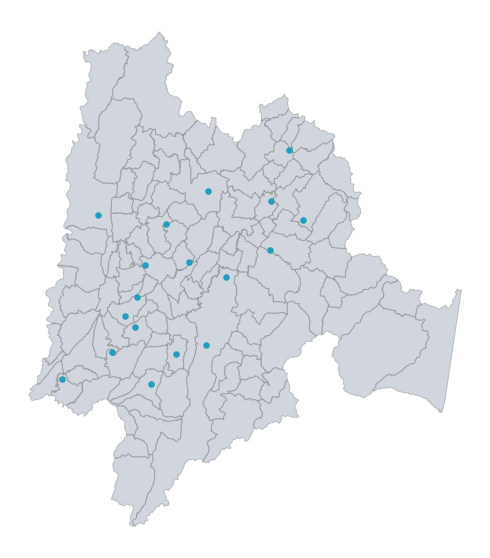

In [ ]:

#mapa con estaciones
fig,ax = plt.subplots(figsize = (20,10))
cundi_map.plot(ax = ax ,alpha = 0.4 , edgecolor='gray', color = "#8d99ae" )
geo_df.plot(ax = ax , markersize = 30,color = "#219ebc")
#remove axes
plt.axis('off')

##plot condicional
# geo_df[geo_df['precipitacion']=='a'].plot(ax = ax , markersize = 30,color = "green")
# geo_df[geo_df['precipitacion']=='m'].plot(ax = ax , markersize = 30,color = "yellow")
# geo_df[geo_df['precipitacion']=='b'].plot(ax = ax , markersize = 30,color = "red")


#print(cundi_map.head())
#print(cundi_map.columns)



In [ ]:
dfp['Precipitacion'] = round(dfp['Precipitacion'],2) 

dfp

geo_df

,estacion,nom_est,ciudad,longitud,latitud,x,y,precipitacion,geometry
0,2306516,Acomodo el,La Vega,-74.309667,5.017667,974254.52,1046611.18,173.24,POINT (974254.520 1046611.180)
1,2120559,Apto Guaymaral,Bogota,-74.053444,4.791000,1002669.44,1021541.32,47.43,POINT (1002669.440 1021541.320)
2,2120644,Argelia,Ricaurte,-74.750778,4.357583,925265.44,973646.84,44.30,POINT (925265.440 973646.840)
3,2120540,Checua,Nemocon,-73.861417,5.116833,1023960.00,1057576.78,14.04,POINT (1023960.000 1057576.780)
4,2120630,Donia juana,Bogota,-74.137333,4.500833,993360.66,989454.46,19.98,POINT (993360.660 989454.460)
5,2120641,Esc samper madrid,Apulo,-74.535694,4.473139,949148.70,986407.56,100.40,POINT (949148.700 986407.560)
6,2306507,Esc vocacional pacho,Pacho,-74.128806,5.158667,994312.55,1062199.05,93.58,POINT (994312.550 1062199.050)
7,2120647,Esperanza la,La Mesa,-74.430278,4.706056,960861.10,1012157.84,101.38,POINT (960861.100 1012157.840)
8,2306517,Guaduas,Guaduas,-74.598278,5.056722,942251.51,1050948.62,135.62,POINT (942251.510 1050948.620)
9,2120562,Guatavita,Guatavita,-73.865583,4.908833,1023505.44,1034575.26,26.81,POINT (1023505.440 1034575.260)


In [ ]:
import altair as alt
from vega_datasets import data

source = data.cars.url

chart = alt.Chart(source).mark_point().encode(
    x='Horsepower:Q',
    y='Miles_per_Gallon:Q',
).properties(
    title='Cars Data'
).configure_title(
    fontSize=25,
    font='Courier',
    anchor='start',
    color='gray'
)

chart

alt.Chart(...)